In [12]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [13]:
### Initial imports
import logging
import numpy as np
import pandas as pd
import pymc3 as pm
import theano.tensor as T
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("ticks")

logging.basicConfig(level=logging.INFO)
log = logging.getLogger(__name__)

import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

from epimodel.pymc3_models import cm_effect
from epimodel.pymc3_models.cm_effect.datapreprocessor import DataPreprocessor

%matplotlib inline

import os
os.environ["THEANO_FLAGS"] = "mode=FAST_RUN,device=gpu,floatX=float32"

In [44]:
SI = np.array(
            [0.04656309, 0.08698277, 0.1121656, 0.11937737, 0.11456359,
             0.10308026, 0.08852893, 0.07356104, 0.059462, 0.04719909,
             0.03683025, 0.02846977, 0.02163222, 0.01640488, 0.01221928,
             0.00903811, 0.00670216, 0.00490314, 0.00361434, 0.00261552,
             0.00187336, 0.00137485, 0.00100352, 0.00071164, 0.00050852,
             0.00036433, 0.00025036]
        )

In [90]:
mu = np.sum([(i+1)*SI[i] for i in range(SI.size)])

In [93]:
sig = (np.sum([(i+1)**2*SI[i] for i in range(SI.size)]) - np.sum([(i+1)*SI[i] for i in range(SI.size)]) ** 2) ** 0.5

In [94]:
sig/mu

0.6148288319898857

In [81]:
nRs = 2
nDs = 500

R = 2.5 * T.ones((nRs, nDs))

infected = T.ones((nRs, nDs + SI.size))
conv_padding = SI.size
for d in range(nDs):
    val = pm.math.sum(R[:, d].reshape((nRs, 1)) * infected[:, d:d + conv_padding] * SI[::-1].reshape((1, conv_padding)), axis=1)
    infected = T.set_subtensor(infected[:, d + conv_padding], val)

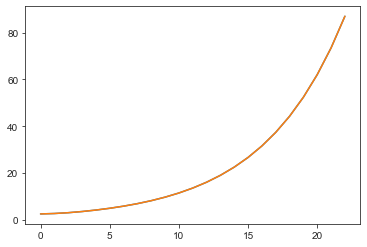

In [84]:
plt.plot(infected.eval()[:, conv_padding:50].T)

INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Performing Smoothing
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Albania
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Andorra
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Estonia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Iceland
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Latvia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Lithuania
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing New Zealand
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Singapore
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Slovakia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Performing Masking


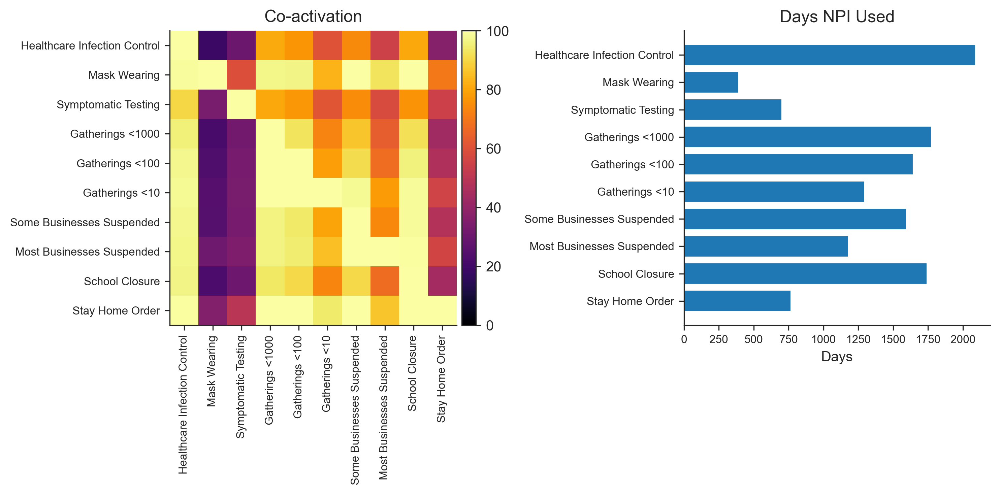

In [14]:
dp = DataPreprocessor()
data = dp.preprocess_data("data_final.csv")

In [4]:
# data.filter_region_min_deaths(1000)

Region AL removed since it has 27.0 deaths on the last day
Region AD removed since it has 40.0 deaths on the last day
Region AT removed since it has 536.0 deaths on the last day
Region BA removed since it has 57.0 deaths on the last day
Region BG removed since it has 55.0 deaths on the last day
Region HR removed since it has 54.0 deaths on the last day
Region CZ removed since it has 218.0 deaths on the last day
Region DK removed since it has 418.0 deaths on the last day
Region EE removed since it has 46.0 deaths on the last day
Region FI removed since it has 186.0 deaths on the last day
Region GE removed since it has 0.0 deaths on the last day
Region GR removed since it has 130.0 deaths on the last day
Region HU removed since it has 262.0 deaths on the last day
Region IS removed since it has 10.0 deaths on the last day
Region IL removed since it has 199.0 deaths on the last day
Region LV removed since it has 12.0 deaths on the last day
Region LT removed since it has 41.0 deaths on the 

In [15]:
def mask_region_ends(d, region, ndays=10):
    i = d.Rs.index(region)
    d.Active.mask[i,-ndays:] = True
    d.Confirmed.mask[i,-ndays:] = True
    d.Deaths.mask[i,-ndays:] = True
    d.NewDeaths.mask[i,-ndays:] = True
    d.NewCases.mask[i,-ndays:] = True

for region in data.Rs:
    mask_region_ends(data, region, 7)

mask_region_ends(data, "ES", 40)
mask_region_ends(data, "FR", 40)

In [16]:
with cm_effect.models.CMActive_Final_ICL(data) as model:
    model.build_model()

In [17]:
model.profile(model.logpt).summary()

Function profiling
  Message: /Users/mrinank/Library/Caches/pypoetry/virtualenvs/epimodel-H-ywULmv-py3.7/lib/python3.7/site-packages/pymc3/model.py:1023
  Time in 1000 calls to Function.__call__: 1.454690e+00s
  Time in Function.fn.__call__: 1.418187e+00s (97.491%)
  Time in thunks: 1.071074e+00s (73.629%)
  Total compile time: 9.065809e-01s
    Number of Apply nodes: 892
    Theano Optimizer time: 1.311302e-05s
       Theano validate time: 0.000000e+00s
    Theano Linker time (includes C, CUDA code generation/compiling): 8.088861e-01s
       Import time 0.000000e+00s
       Node make_thunk time 7.782550e-01s
           Node Subtensor{::, int64}(Elemwise{exp,no_inplace}.0, Constant{81}) time 3.298118e-01s
           Node InplaceDimShuffle{x}(TensorConstant{20.0}) time 1.538992e-03s
           Node InplaceDimShuffle{x}(TensorConstant{-inf}) time 1.525879e-03s
           Node InplaceDimShuffle{x}(TensorConstant{1}) time 1.413107e-03s
           Node Reshape{2}(Subtensor{::, int64}.0, Ten

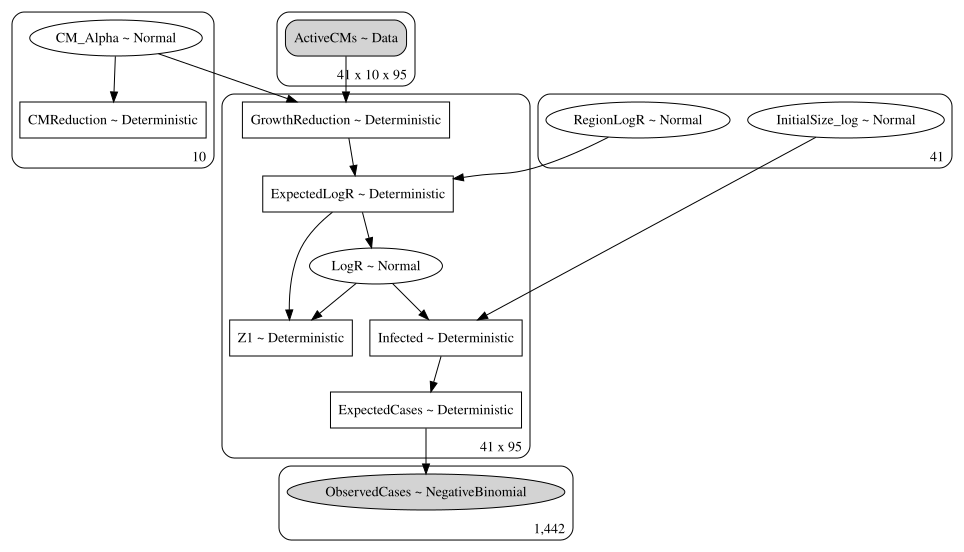

In [18]:
pm.model_to_graphviz(model).render("model-active-final-ICL")
pm.model_to_graphviz(model)

In [19]:
with model.model:
    model.trace = pm.sample(2000, chains=2)

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 4 jobs)
NUTS: [InitialSize_log, LogR, RegionLogR, CM_Alpha]
INFO:pymc3:NUTS: [InitialSize_log, LogR, RegionLogR, CM_Alpha]
Sampling 2 chains, 0 divergences: 100%|██████████| 5000/5000 [52:48<00:00,  1.58draws/s]  
The rhat statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
INFO:pymc3:The rhat statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
The estimated number of effective samples is smaller than 200 for some parameters.
ERROR:pymc3:The estimated number of effective samples is smaller than 200 for some parameters.


INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;02-48
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;02-48


<Figure size 2100x900 with 0 Axes>

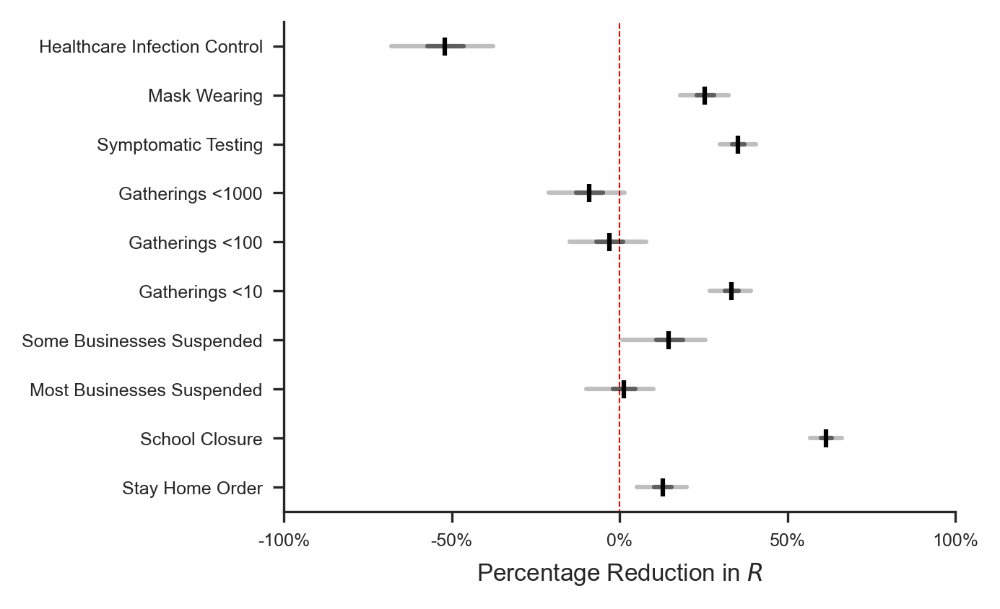

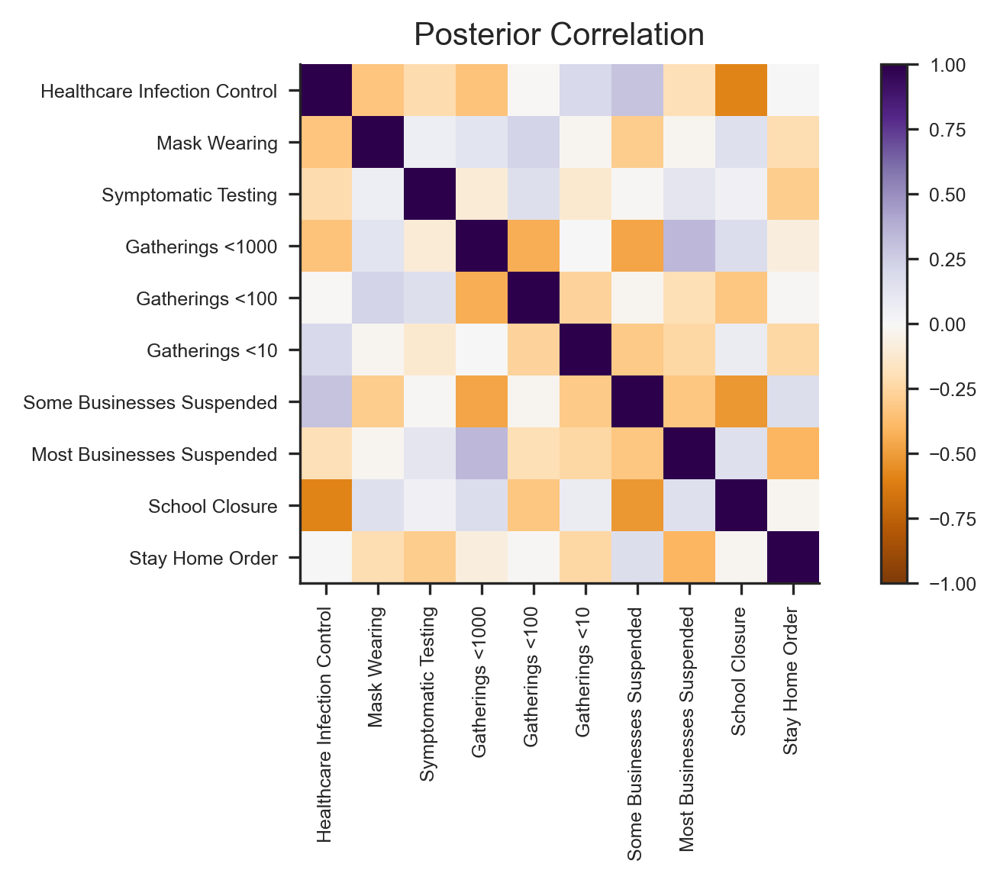

In [20]:
model.plot_effect()

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;13-41
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;13-41
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;13-42
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;13-42
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;13-42
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;13-42
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspac

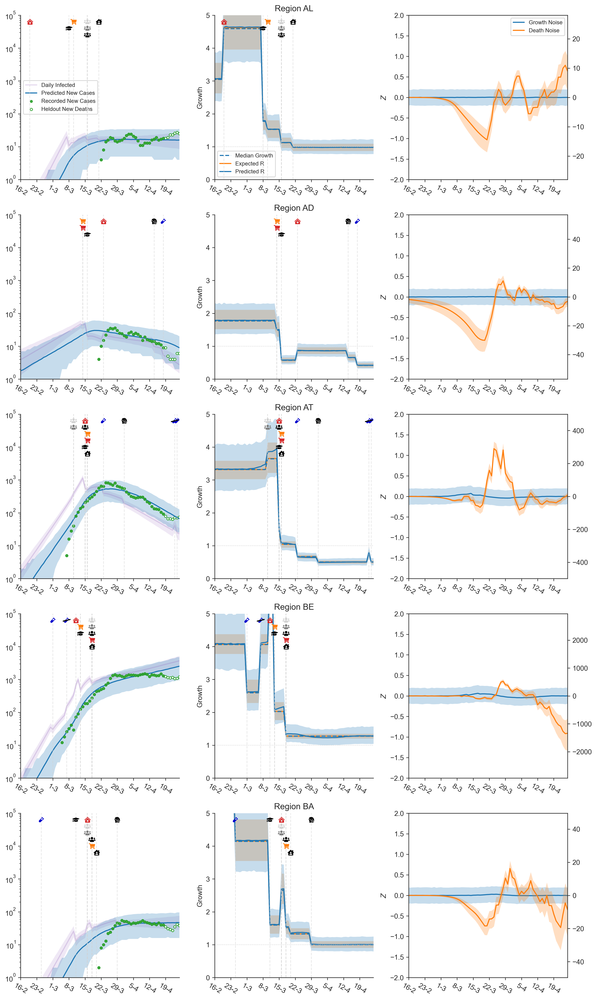

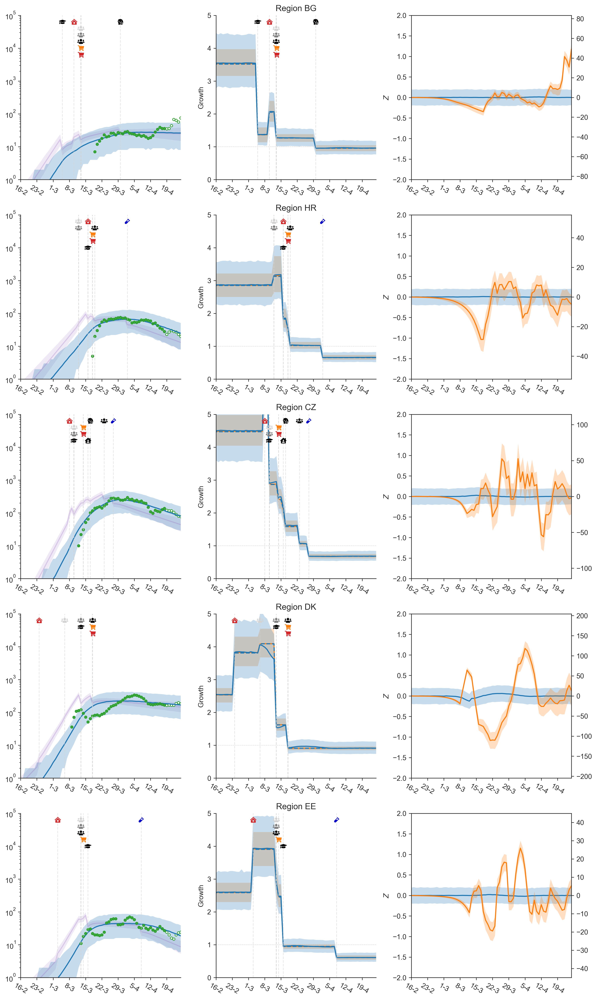

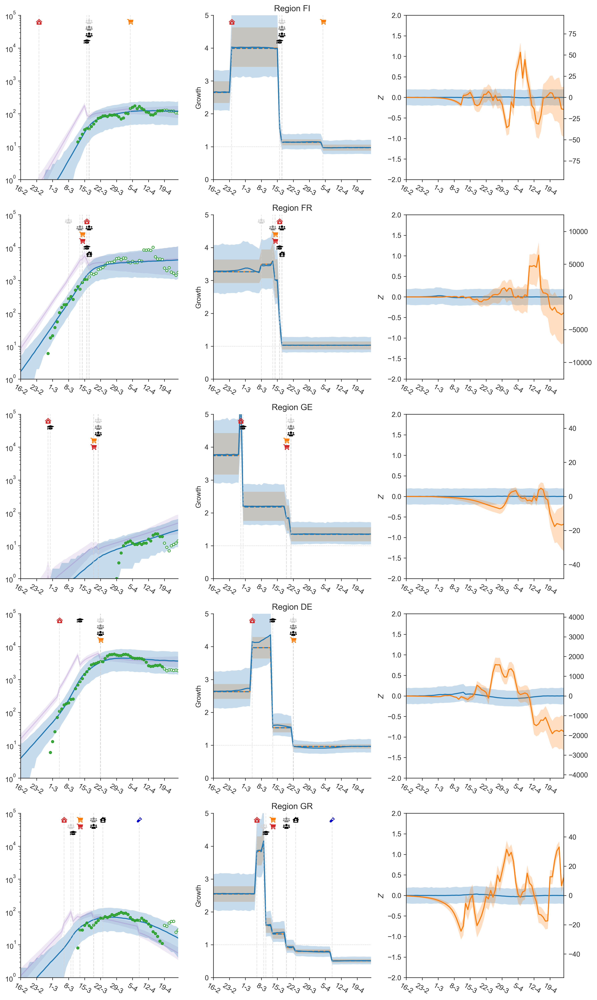

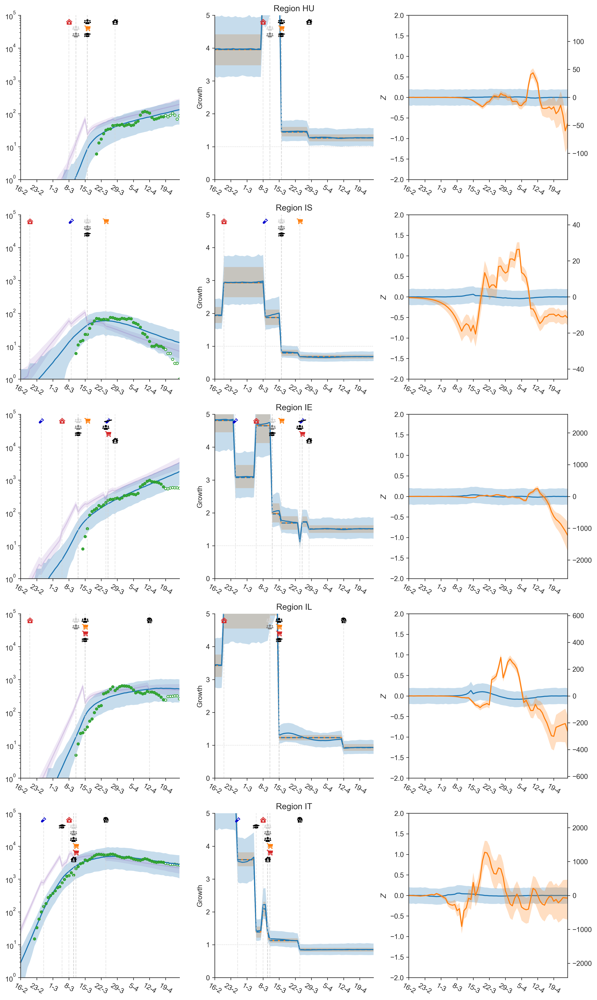

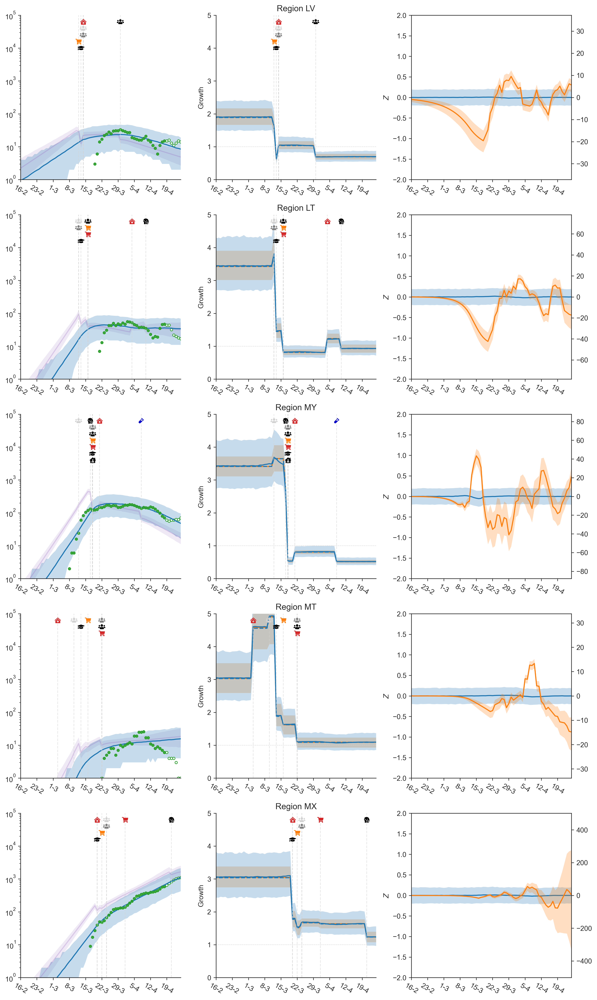

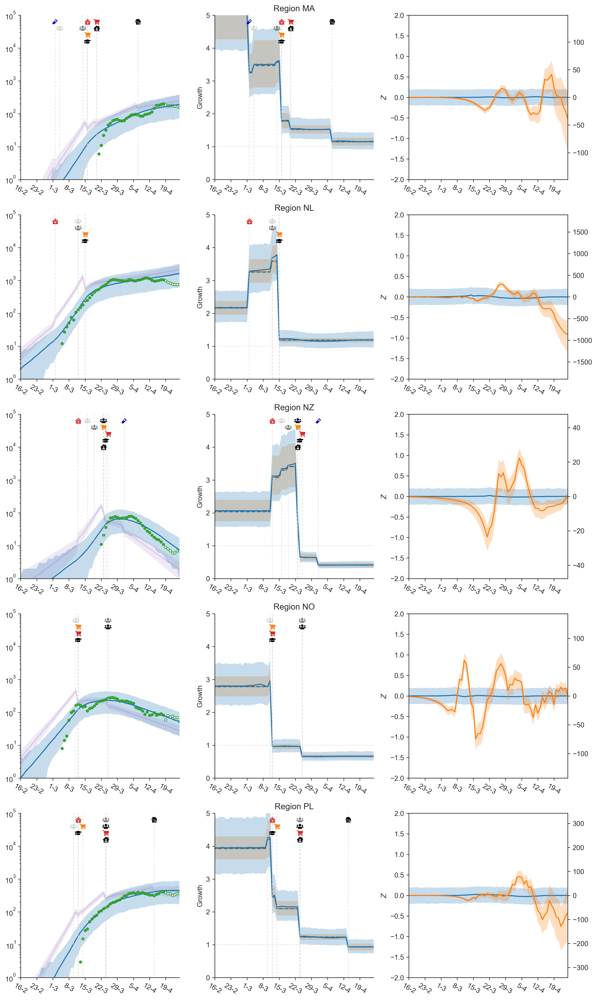

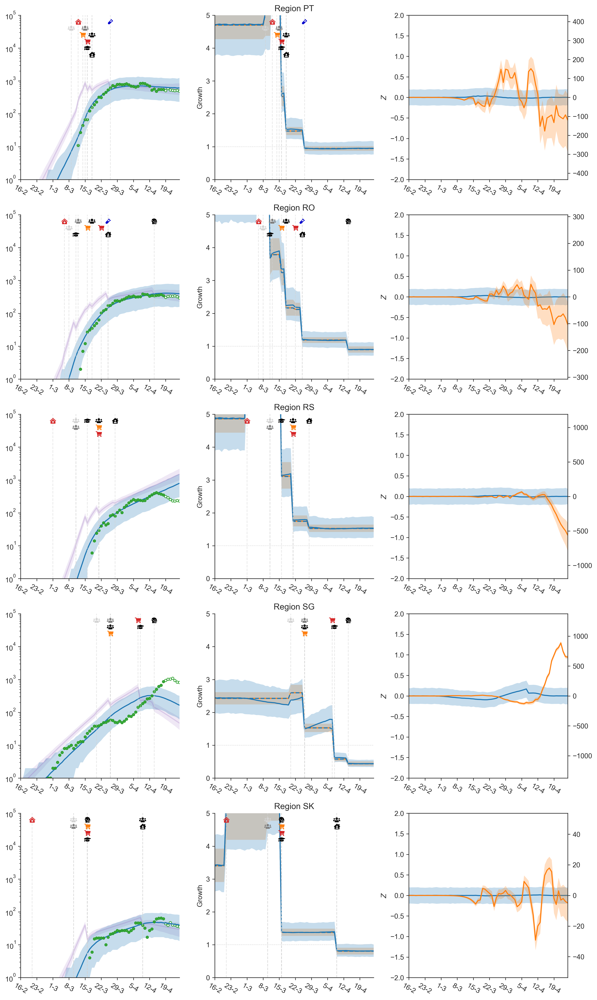

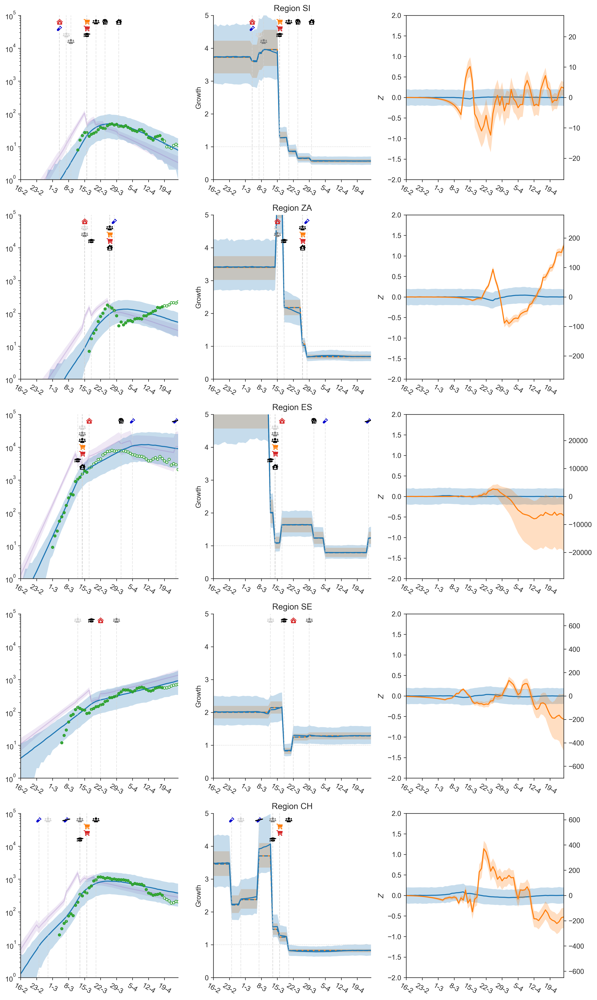

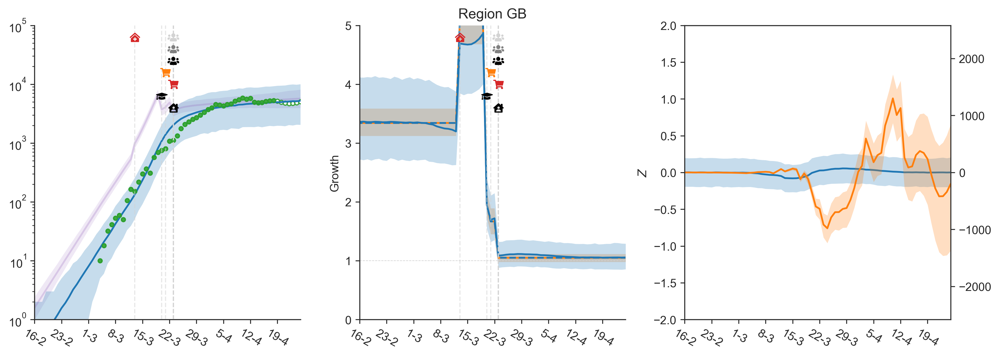

In [41]:
cm_plot_style = [
            ("\uf7f2", "tab:red"), # hospital symbol
            ("\uf963", "black"), # mask
            ("\uf492", "mediumblue"), # vial
            ("\uf0c0", "lightgrey"), # ppl
            ("\uf0c0", "grey"), # ppl
            ("\uf0c0", "black"), # ppl
            ("\uf07a", "tab:orange"), # shop 1
            ("\uf07a", "tab:red"), # shop2 
            ("\uf19d", "black"), # school
            ("\uf965", "black") # home
        ]

model.plot_region_predictions(cm_plot_style)

In [43]:
model.trace.Phi

AttributeError: 'MultiTrace' object has no attribute 'Phi'

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;13-30
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;13-30


<Figure size 2100x900 with 0 Axes>

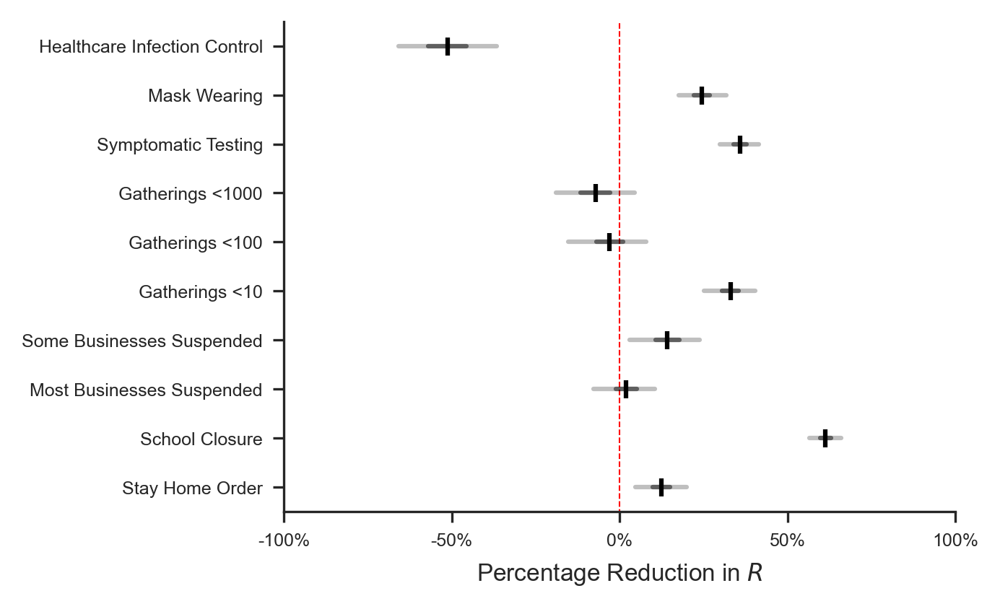

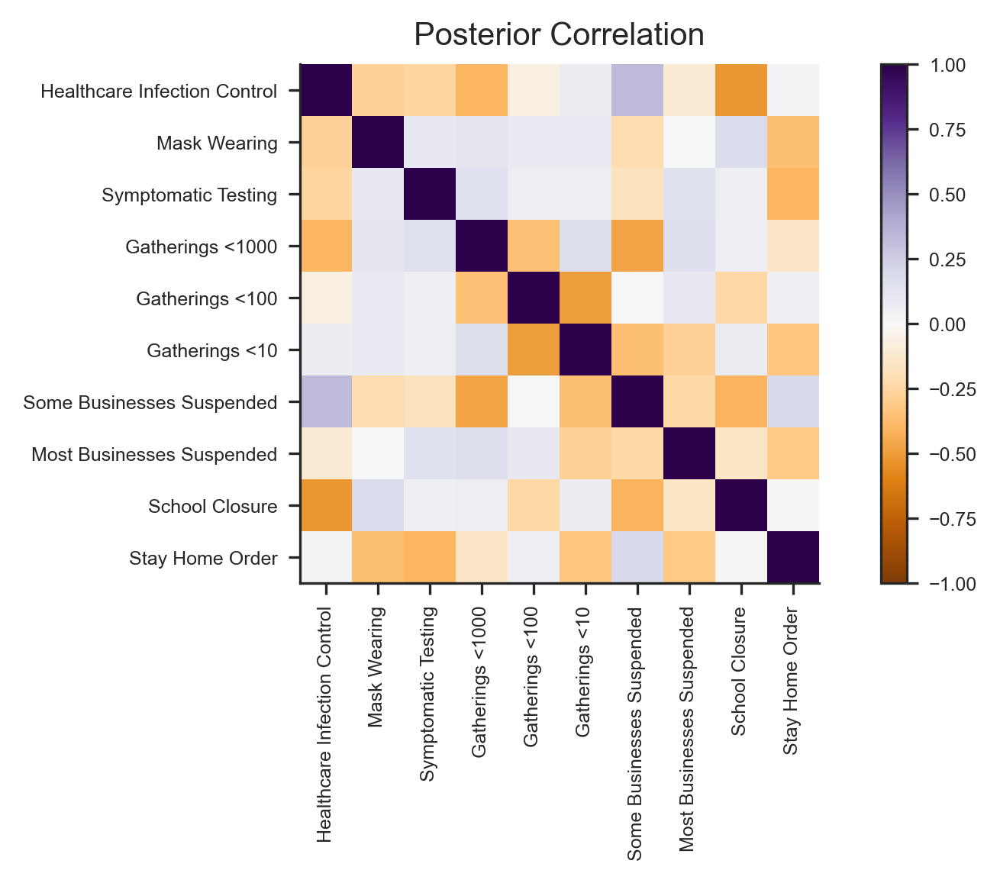

In [33]:
model.plot_effect()

In [49]:
with cm_effect.models.CMActive_Final_ICL(data) as model2:
    model2.build_model()

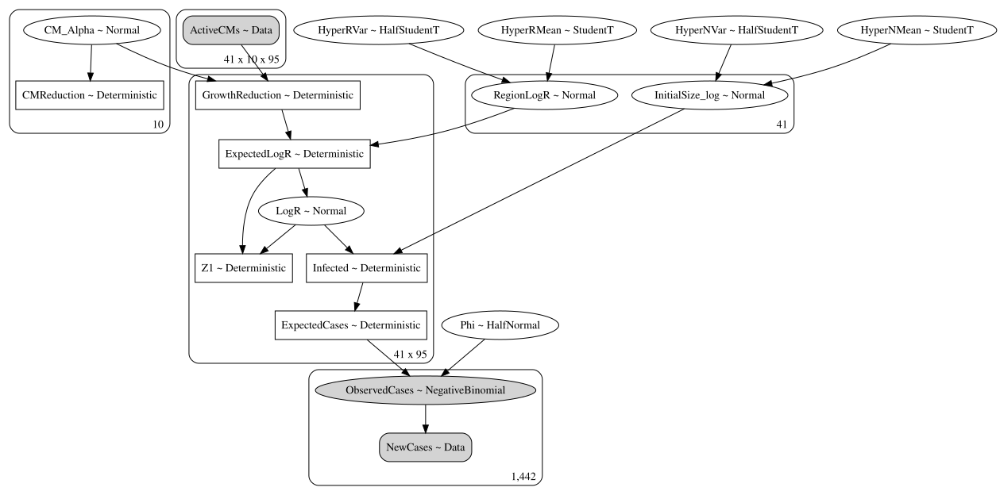

In [50]:
pm.model_to_graphviz(model2).render("model-active-final-ICL")
pm.model_to_graphviz(model2)

In [51]:
with model2.model:
    model2.trace = pm.sample(2000, chains=2)

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 4 jobs)
NUTS: [Phi, InitialSize_log, HyperNVar, HyperNMean, LogR, RegionLogR, HyperRVar, HyperRMean, CM_Alpha]
INFO:pymc3:NUTS: [Phi, InitialSize_log, HyperNVar, HyperNMean, LogR, RegionLogR, HyperRVar, HyperRMean, CM_Alpha]
Sampling 2 chains, 0 divergences: 100%|██████████| 5000/5000 [55:25<00:00,  1.50draws/s] 
The rhat statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
INFO:pymc3:The rhat statistic is larger than 1.05 for some parameters. This indicates slight problems during sampling.
The estimated number of effective samples is smaller than 200 for some parameters.
ERROR:pymc3:The estimated number of effective samples is smaller than 200 for some parameters.


INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;14-50
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;14-50


<Figure size 2100x900 with 0 Axes>

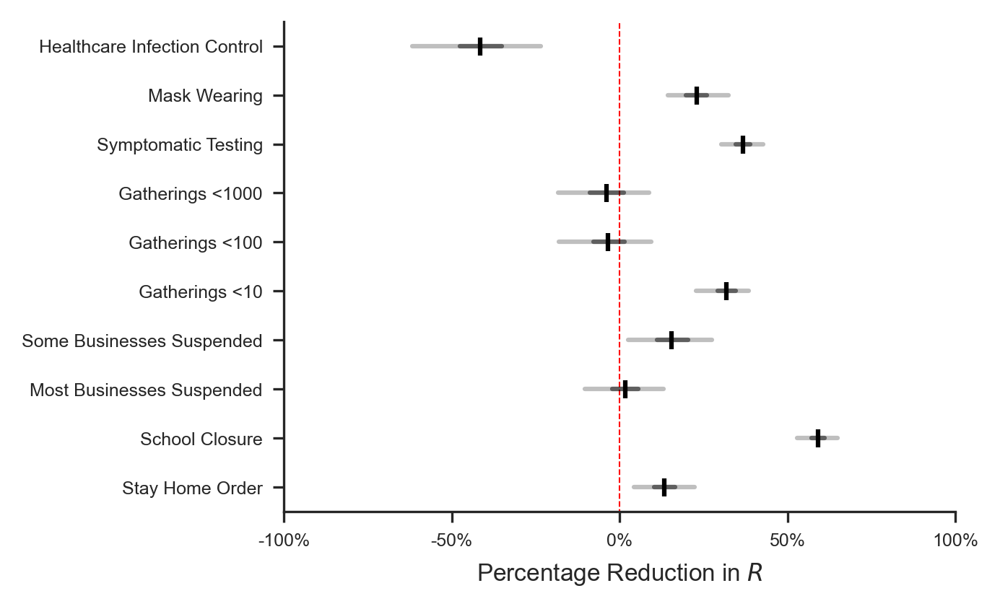

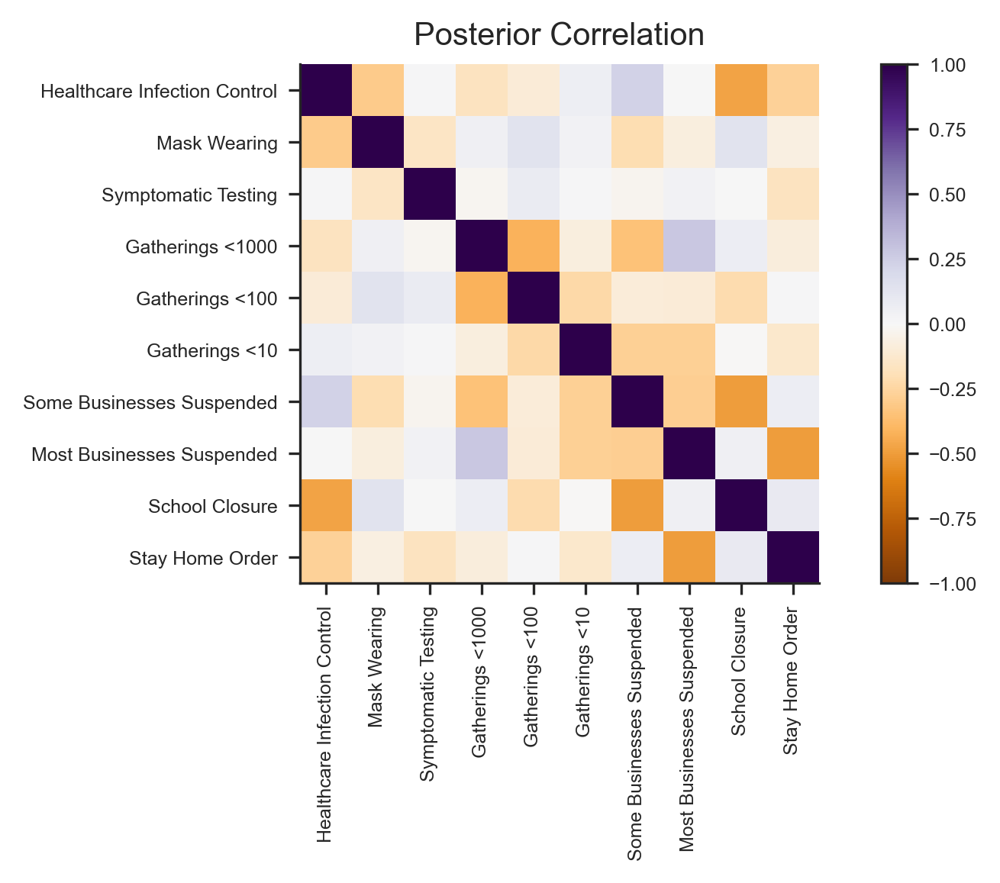

In [53]:
model2.plot_effect()

In [57]:
np.mean(model2.trace["CMReduction"][:, 0])

1.4150174626471879

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;14-54
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;14-54
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;14-54
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;14-54
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;14-54
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 09-05;14-55
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspac

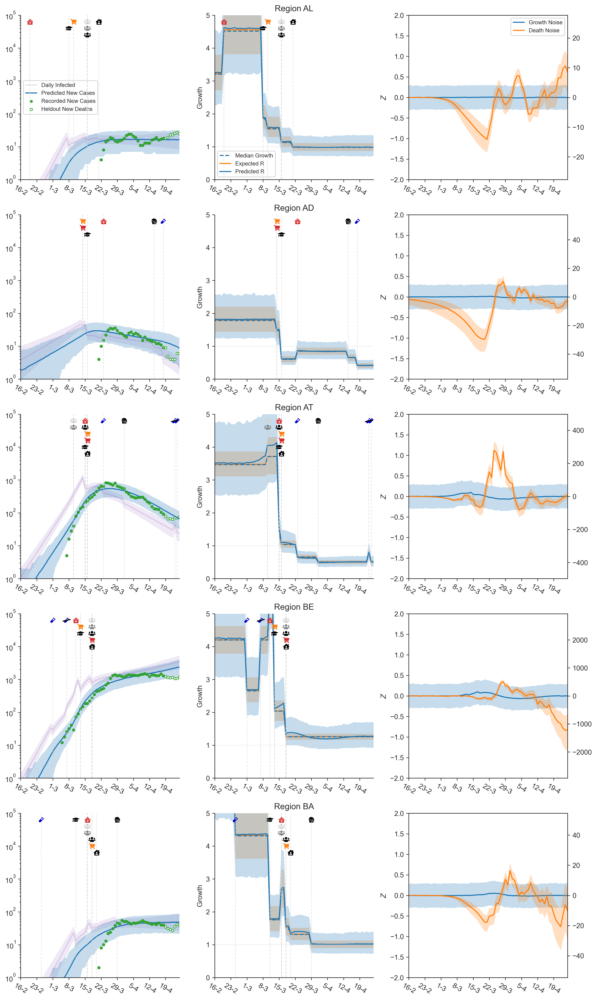

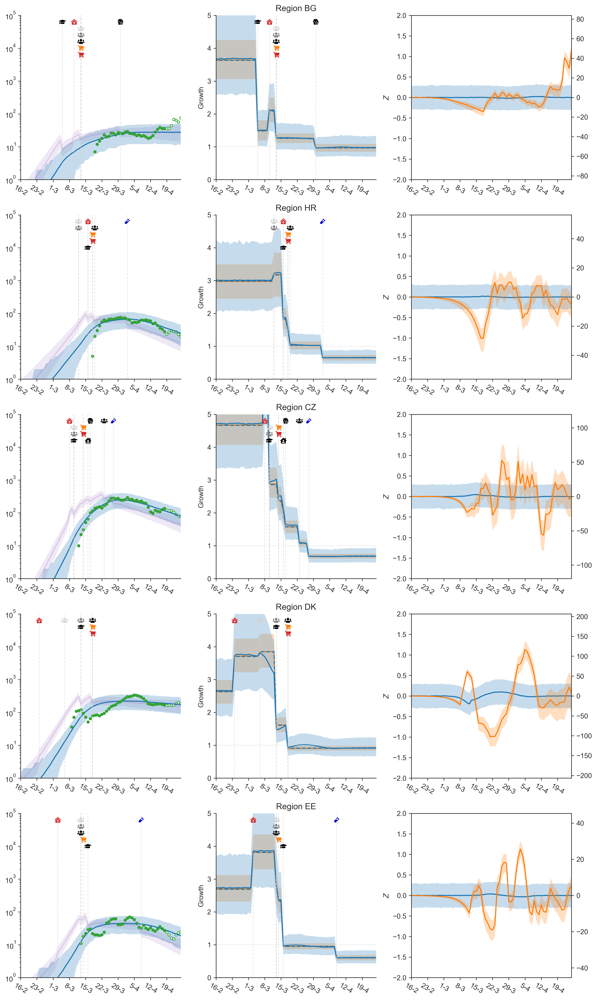

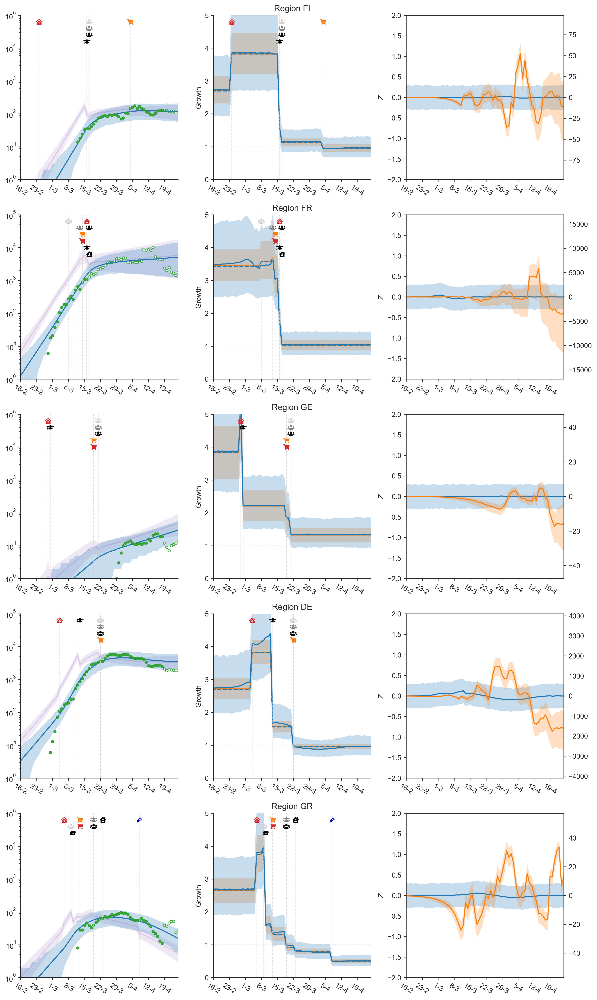

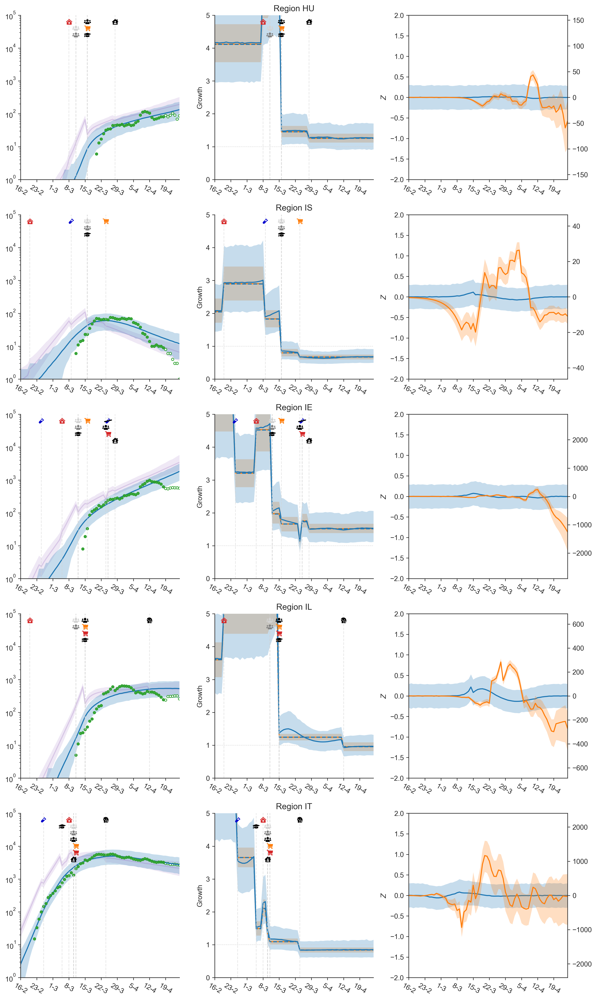

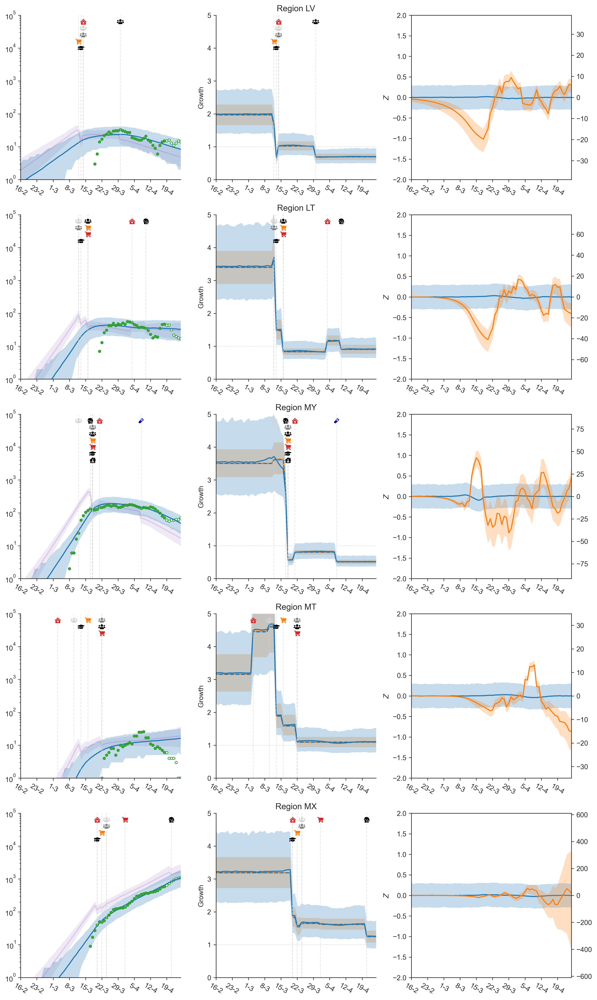

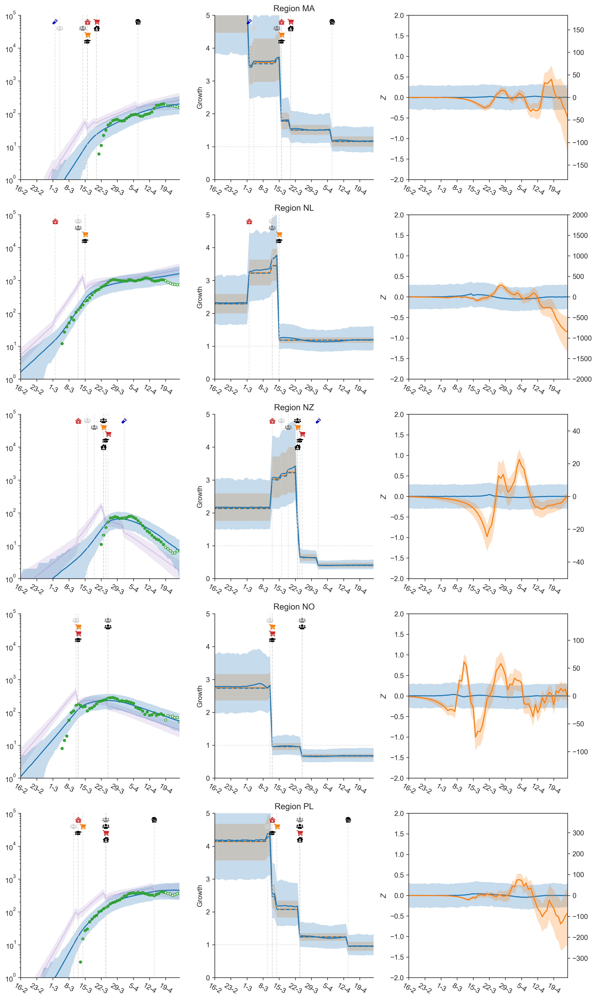

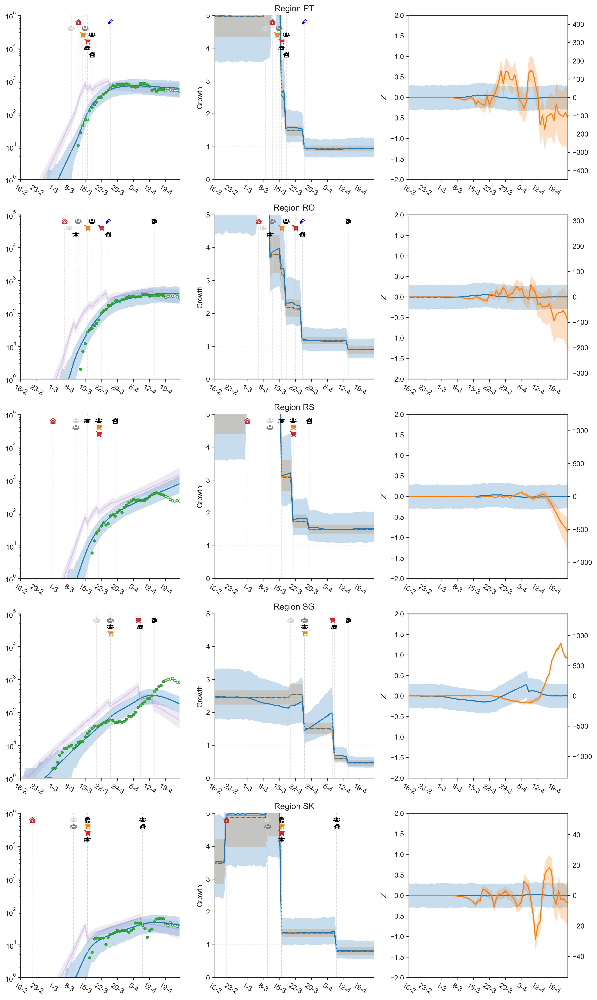

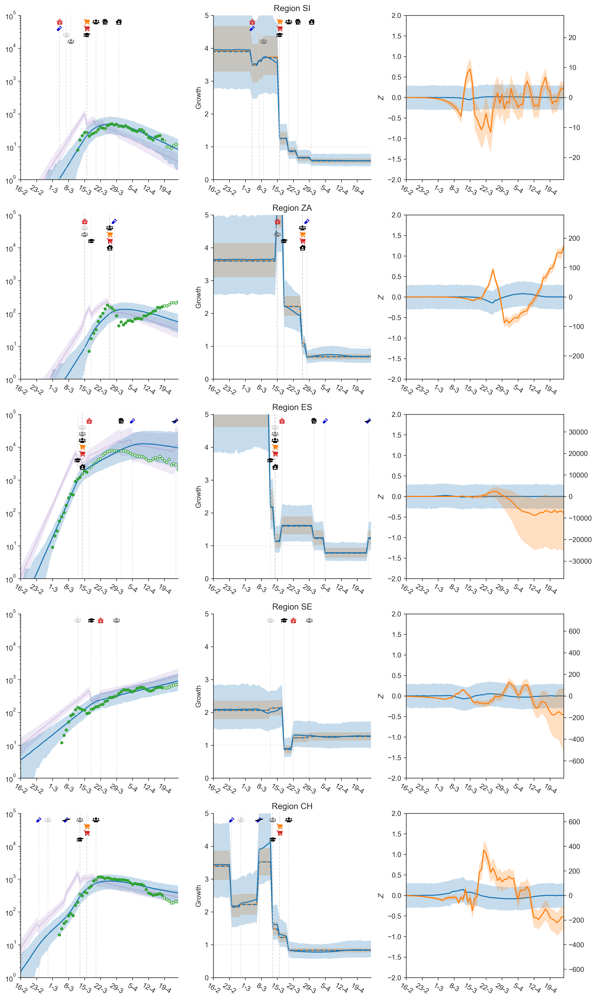

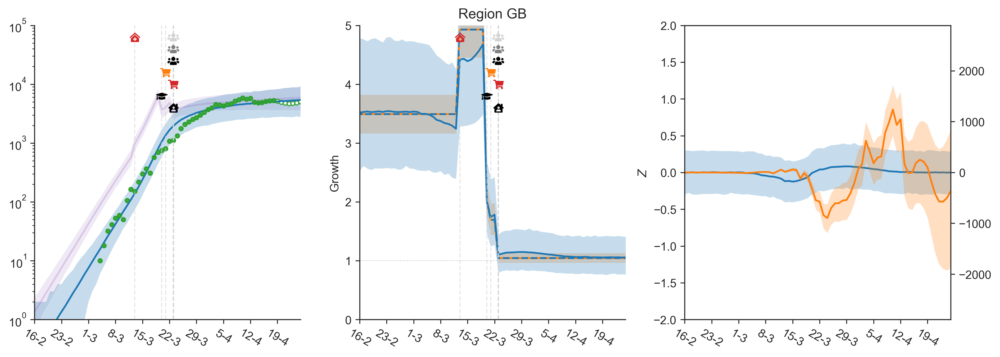

In [60]:
model2.plot_region_predictions(cm_plot_style)

In [ ]:
for i, cm in enumerate(model.d.CMs):
    print(f"CM: {cm} mean: {np.mean(model.trace['CMReduction'][:, i]):.3f} [{np.percentile(model.trace['CMReduction'][:, i], 2.5):.3f}, {np.percentile(model.trace['CMReduction'][:, i], 97.5):.3f}]")

In [62]:
DelayProb = np.array([0.00509233, 0.02039664, 0.03766875, 0.0524391, 0.06340527,
                                   0.07034326, 0.07361858, 0.07378182, 0.07167229, 0.06755999,
                                   0.06275661, 0.05731038, 0.05141595, 0.04565263, 0.04028695,
                                   0.03502109, 0.03030662, 0.02611754, 0.02226727, 0.0188904,
                                   0.01592167, 0.01342368, 0.01127307, 0.00934768, 0.00779801,
                                   0.00645582, 0.00534967, 0.00442695])

In [63]:
DelayProb.size

28

In [59]:
np.mean(model2.trace.Phi)

14.884149816092853

In [67]:
np.mean(model2.trace.HyperRVar)

0.3515256756503074

In [69]:
model2.d.Confirmed.data[0, :]

array([ nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,
        nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,
        nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,
        nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,
        nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,  nan,
        nan,  nan,  nan,  nan,  nan,  nan, 104., 123., 146., 174., 186.,
       197., 212., 223., 243., 259., 277., 304., 333., 361., 377., 383.,
       400., 409., 416., 433., 446., 467., 475., 494., 518., 539., 548.,
       562., 584., 609., 634., 663., 678., 712.])

In [70]:
model2.d.NewCases.mask[0, :]

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False,  True,  True,
        True,  True,  True,  True,  True])

In [80]:
model2.observed_days[:30]

array([ 61,  62,  63,  64,  65,  66,  67,  68,  69,  70,  71,  72,  73,
        74,  75,  76,  77,  78,  79,  80,  81,  82,  83,  84,  85,  86,
        87, 155, 156, 157])

In [79]:
np.nonzero(~np.isnan(model2.d.Confirmed.data[0, :]))

(array([61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77,
        78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94]),)